In [1]:
using Plots
using CSV
using DataFrames
using Glob
using JLD2
using ProgressMeter
using Printf

In [2]:
using GalaxySim

[ Info: Precompiling GalaxySim [acb07f55-bd29-4b0d-84d7-cda6267f5828]


In [3]:
function get_col(symb)
    arr = zeros(N, Nt)
    
    for n in 1:N
        for i in 1:Nt
            arr[n, i] = getproperty(ps[i][n], symb)

        end
    end
    return arr
end

function get_i(symb, idx=1)
    arr = zeros(N, Nt)
    
    for n in 1:N
        for i in 1:Nt
            arr[n, i] = getproperty(ps[i][n], symb)[idx]

        end
    end
    return arr
end

get_i (generic function with 2 methods)

In [13]:
@load "mass.jld" masses
@load "result.jld" t u

ps = [GalaxySim.Evolve.matrix_to_particles(p, masses)
    for p in u];
N = length(ps[1])
Nt = length(ps)

x1s = get_i(:x) /pc
x2s = get_i(:x, 2) /pc
x3s = get_i(:x, 3) / pc

ρs = get_col(:ρ) * pc^3 / Msun
Ts = get_col(:T);
Mss = get_col(:mstar) / Msun;

Progress: 100%|█████████████████████████████████████████| Time: 0:00:13
[ Info: Saved animation to /home/daniel/.julia/dev/GalaxySim/tmp.gif


Plots.AnimatedGif("/home/daniel/.julia/dev/GalaxySim/tmp.gif")
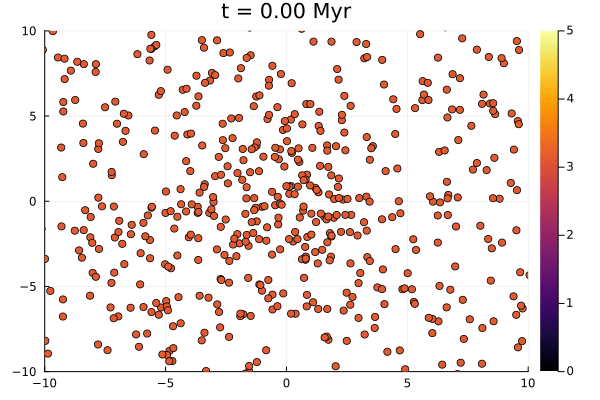

In [19]:
prog = Progress(Nt)

Rv = 10

function plot_gal(x, y, c, Rv, t)    
    scatter(x, y, marker_z=c, clim=(0,5), xlim=[-Rv, Rv], ylim=[-Rv, Rv], legend=false, colorbar=true)
    title!(@sprintf("t = %2.2f Myr", t/1e6yr))  
end


@gif for i ∈ 1:Nt
    filt = x3s[:, i] .< Rv
    plot_gal(x1s[filt, i], x2s[filt, i], log10.(Ts[filt, i] .+ 1), Rv, t[i])
    next!(prog)
end

In [17]:
minimum(get_col(:ρ))

8.048460842800667e-29

In [16]:
maximum(get_col(:ρ))

1.1039310319400064e-20

In [48]:
(ps[5][1].mgas/ps[5][1].ρ/pc^3)^1/3

270752.46447520994

In [34]:
maximum(ρs)*Msun/pc^3

5.780141017439042e-22

Progress: 100%|█████████████████████████████████████████| Time: 0:00:04
[ Info: Saved animation to /home/daniel/.julia/dev/GalaxySim/tmp.gif


Plots.AnimatedGif("/home/daniel/.julia/dev/GalaxySim/tmp.gif")
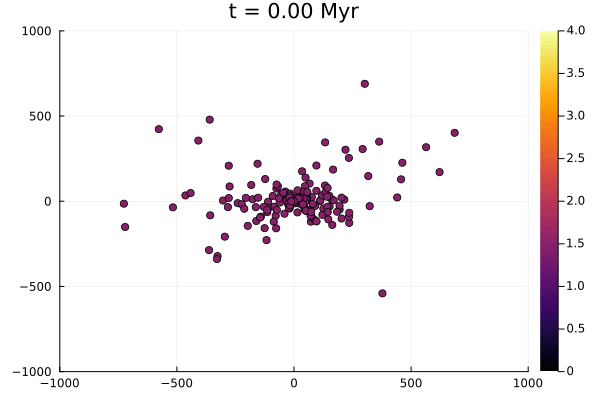

In [31]:
prog = Progress(Nt)


@gif for i ∈ 1:Nt
    filt = Ts[:, i] .>= 0
    
    x1 = x1s[filt,i]
    x2 = x2s[filt,i]
    
    c= log10.(Ts[filt, i] .+1)


    scatter(x1, x2, marker_z=c, clim=(0,4), xlim=[-1000, 1000], ylim=[-1000, 1000], legend=false, colorbar=true)
    title!(@sprintf("t = %2.2f Myr", t[i]/1e6yr))
    
    next!(prog)
end

[ Info: Saved animation to /home/daniel/.julia/dev/GalaxySim/tmp.gif


Plots.AnimatedGif("/home/daniel/.julia/dev/GalaxySim/tmp.gif")
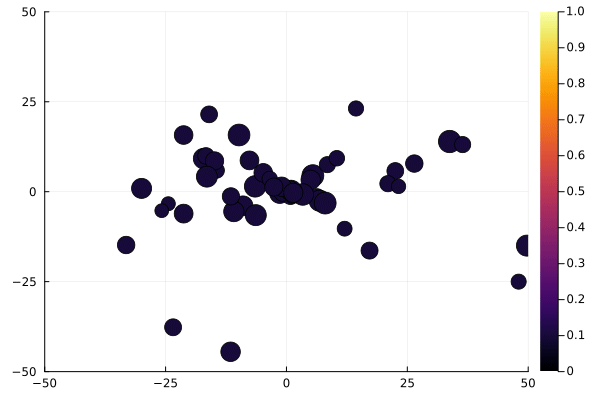

In [38]:
@gif for i ∈ 1:1000
    
    x_max = 50
    r_max = 20
    
    x3 = x3s[:,i]
    x1 = x1s[:,i]
    x2 = x2s[:,i]
    c= abs.(ρs[:, i])
    
    filt = abs.(x3) .< r_max
    s = (x_max .- abs.(x3))/r_max * 5
    
    scatter(x1[filt], x2[filt], marker_z=c[filt], ms=s[filt], clim=(0, 1), xlim=[-x_max, x_max], ylim=[-x_max, x_max], legend=false, colorbar=true)
end

In [11]:
log10(10)

1.0

[ Info: Saved animation to /home/daniel/.julia/dev/GalaxySim/tmp.gif


Plots.AnimatedGif("/home/daniel/.julia/dev/GalaxySim/tmp.gif")
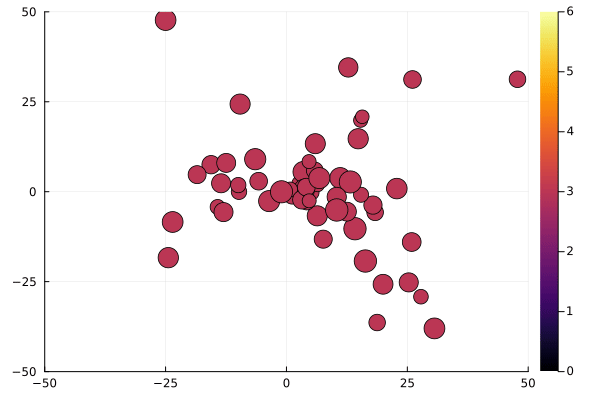

In [12]:
@gif for i ∈ 1:1000
    
    x_max = 50
    r_max = 20
    
    x3 = x3s[:,i]
    x1 = x1s[:,i]
    x2 = x2s[:,i]
    c= log10.(abs.(Ts[:, i]))
    
    filt = abs.(x3) .< r_max
    s = (x_max .- abs.(x3))/r_max * 5
    
    scatter(x1[filt], x2[filt], marker_z=c[filt], ms=s[filt], clim=(0, 6), xlim=[-x_max, x_max], ylim=[-x_max, x_max], legend=false, colorbar=true)
end